In [3]:
import os
import json
import torch
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
from PIL import Image
from torch import nn
from torch.utils.data import Dataset, DataLoader
from sklearn.metrics import classification_report

Epoch 1 | Loss: 99.7850
Epoch 2 | Loss: 52.3280
Epoch 3 | Loss: 31.8855
Epoch 4 | Loss: 21.4556
Epoch 5 | Loss: 15.4064
Epoch 6 | Loss: 11.5438
Epoch 7 | Loss: 8.7459
Epoch 8 | Loss: 6.8090
Epoch 9 | Loss: 5.3193
Epoch 10 | Loss: 4.1975

--- Classification Report ---
                 precision    recall  f1-score   support

     back_wheel       1.00      0.33      0.50         3
    back_handle       0.93      1.00      0.97        14
           bell       0.95      1.00      0.98        63
          chain       1.00      1.00      1.00        67
          steer       1.00      0.33      0.50         9
           lock       0.97      1.00      0.99        33
     back_light       1.00      1.00      1.00        60
   front_handle       1.00      0.40      0.57         5
    dress_guard       1.00      1.00      1.00        78
    front_pedal       1.00      1.00      1.00         4
     back_pedal       1.00      1.00      1.00        57
front_handbreak       0.94      0.97      0.95 

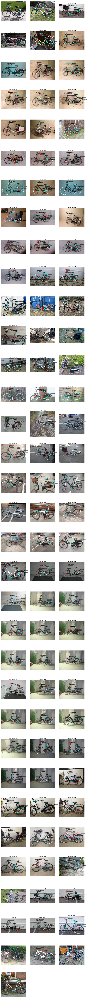

In [4]:
# --- Device Setup ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# --- Load Annotations ---
with open("../new_annotations.json", "r") as f:
    annotations = json.load(f)

all_parts = annotations["all_parts"]
all_parts_idx = {p: i for i, p in enumerate(all_parts)}
image_names = list(annotations["images"].keys())

# --- Train/Test Split ---
train_images = image_names[:1000]
test_images = image_names[-100:]

# --- Helper: Get bbox center ---
def bbox_center(bbox):
    x = bbox["left"] + bbox["width"] / 2
    y = bbox["top"] + bbox["height"] / 2
    return np.array([x, y])

# --- Graph builder ---
def build_graph(parts):
    G = nx.Graph()
    for i, a in enumerate(parts):
        for j, b in enumerate(parts):
            if i >= j:
                continue
            p1 = bbox_center(a["relative_bounding_box"])
            p2 = bbox_center(b["relative_bounding_box"])
            dist = np.linalg.norm(p1 - p2)
            G.add_edge(a["part_name"], b["part_name"], weight=dist)
    return G

# --- Dataset Class ---
class MSTGraphDataset(Dataset):
    def __init__(self, image_list, annotations, transform=None):
        self.images = image_list
        self.annotations = annotations["images"]
        self.all_parts = annotations["all_parts"]
        self.transform = transform

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_name = self.images[idx]
        ann = self.annotations[img_name]
        parts = ann["available_parts"]

        # Build MST
        G = build_graph(parts)
        T = nx.minimum_spanning_tree(G)

        # Create adjacency matrix
        adj_vector = np.zeros((len(self.all_parts), len(self.all_parts)))
        for u, v in T.edges:
            i = all_parts_idx[u]
            j = all_parts_idx[v]
            adj_vector[i, j] = 1
            adj_vector[j, i] = 1
        adj_vector = torch.tensor(adj_vector).flatten().float()

        # Binary vector for missing parts
        y = torch.zeros(len(self.all_parts))
        for p in ann["missing_parts"]:
            y[all_parts_idx[p]] = 1

        return adj_vector, y

# --- Data Loaders ---
train_dataset = MSTGraphDataset(train_images, annotations)
test_dataset = MSTGraphDataset(test_images, annotations)
train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

# --- Model ---
class MSTClassifier(nn.Module):
    def __init__(self, input_size, output_size):
        super().__init__()
        self.model = nn.Sequential(
            nn.Linear(input_size, 128),
            nn.ReLU(),
            nn.Linear(128, output_size),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.model(x)

model = MSTClassifier(len(all_parts)**2, len(all_parts)).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
criterion = nn.BCELoss()

# --- Training Function ---
def train():
    model.train()
    for epoch in range(10):
        total_loss = 0
        for x, y in train_loader:
            x, y = x.to(device), y.to(device)
            optimizer.zero_grad()
            out = model(x)
            loss = criterion(out, y)
            loss.backward()
            optimizer.step()
            total_loss += loss.item()
        print(f"Epoch {epoch+1} | Loss: {total_loss:.4f}")

# --- Evaluation Function ---
def evaluate():
    model.eval()
    y_true, y_pred = [], []
    with torch.no_grad():
        for x, y in test_loader:
            x = x.to(device)
            out = model(x).cpu()
            preds = (out > 0.5).int().squeeze(0).tolist()
            y_pred.append(preds)
            y_true.append(y.squeeze(0).int().tolist())
    print("\n--- Classification Report ---")
    print(classification_report(y_true, y_pred, target_names=all_parts, zero_division=0))

# --- Visualize All MSTs ---
def visualize_all_msts(image_folder, test_images, annotations, cols=3):
    rows = (len(test_images) + cols - 1) // cols
    fig, axs = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))
    axs = axs.flatten()

    for i, img_name in enumerate(test_images):
        ann = annotations["images"][img_name]
        parts = ann["available_parts"]

        if len(parts) < 2:
            axs[i].axis('off')
            continue

        G = build_graph(parts)
        T = nx.minimum_spanning_tree(G)

        image_path = os.path.join(image_folder, img_name)
        image = Image.open(image_path)
        axs[i].imshow(image)
        axs[i].axis('off')
        axs[i].set_title(img_name, fontsize=8)

        centers = {}
        for part in parts:
            name = part["part_name"]
            bbox = part["absolute_bounding_box"]
            cx = bbox["left"] + bbox["width"] / 2
            cy = bbox["top"] + bbox["height"] / 2
            centers[name] = (cx, cy)
            axs[i].plot(cx, cy, 'ro')
            axs[i].text(cx + 3, cy, name, fontsize=6, color='white',
                        bbox=dict(facecolor='black', alpha=0.5, pad=1))

        for u, v in T.edges:
            x1, y1 = centers[u]
            x2, y2 = centers[v]
            axs[i].plot([x1, x2], [y1, y2], 'cyan', linewidth=1.5)

    # Hide unused subplots
    for j in range(i + 1, len(axs)):
        axs[j].axis('off')

    plt.tight_layout()
    plt.show()

# --- Run Everything ---
train()
evaluate()
visualize_all_msts("../DelftBikes/train/", test_images, annotations)